<a href="https://colab.research.google.com/github/QuangLe102/AI/blob/main/code_hoan_chinh_chua_train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install keras

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
pip install efficientnet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 50 kB 6.6 MB/s 


In [3]:
pip install Pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
#import thư viện
import efficientnet.tfkeras as efn 
import IPython.display as ipd
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from efficientnet.keras import preprocess_input
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from sklearn.utils import class_weight
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
import glob
import numpy as np
import pandas as pd
import os
import wave
import pylab

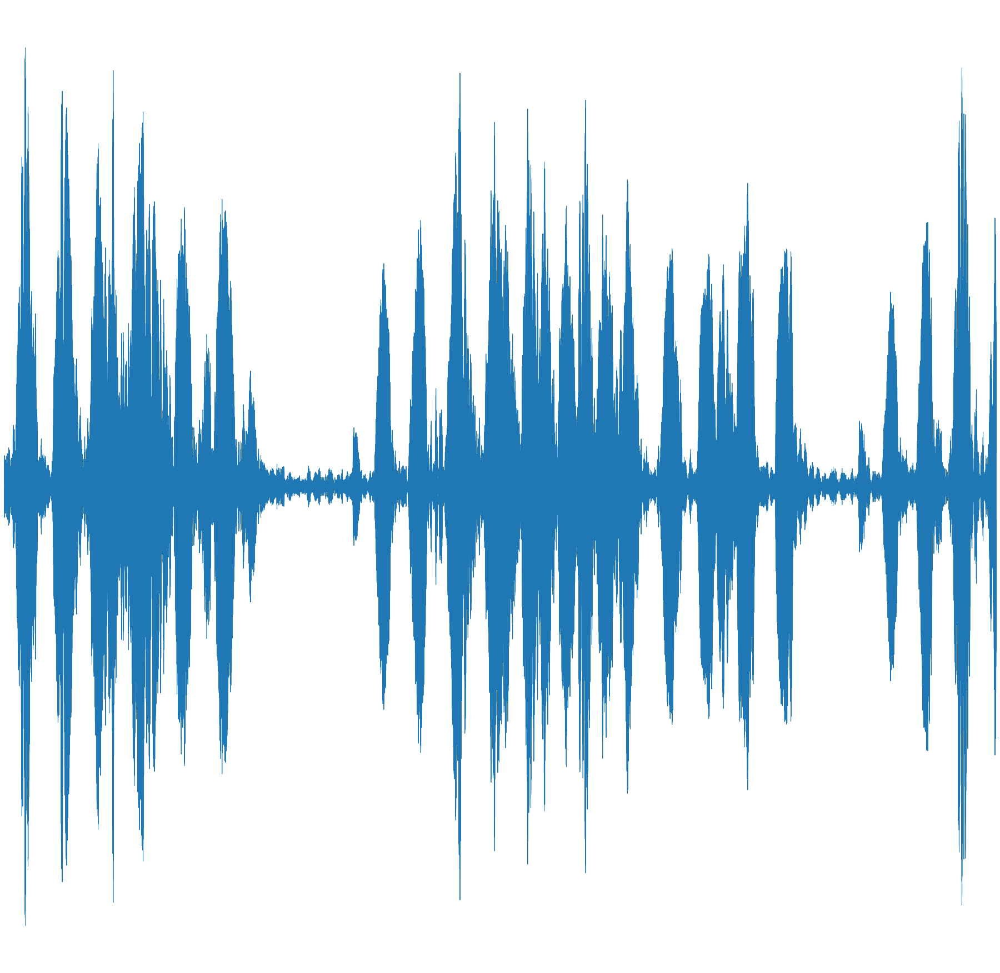

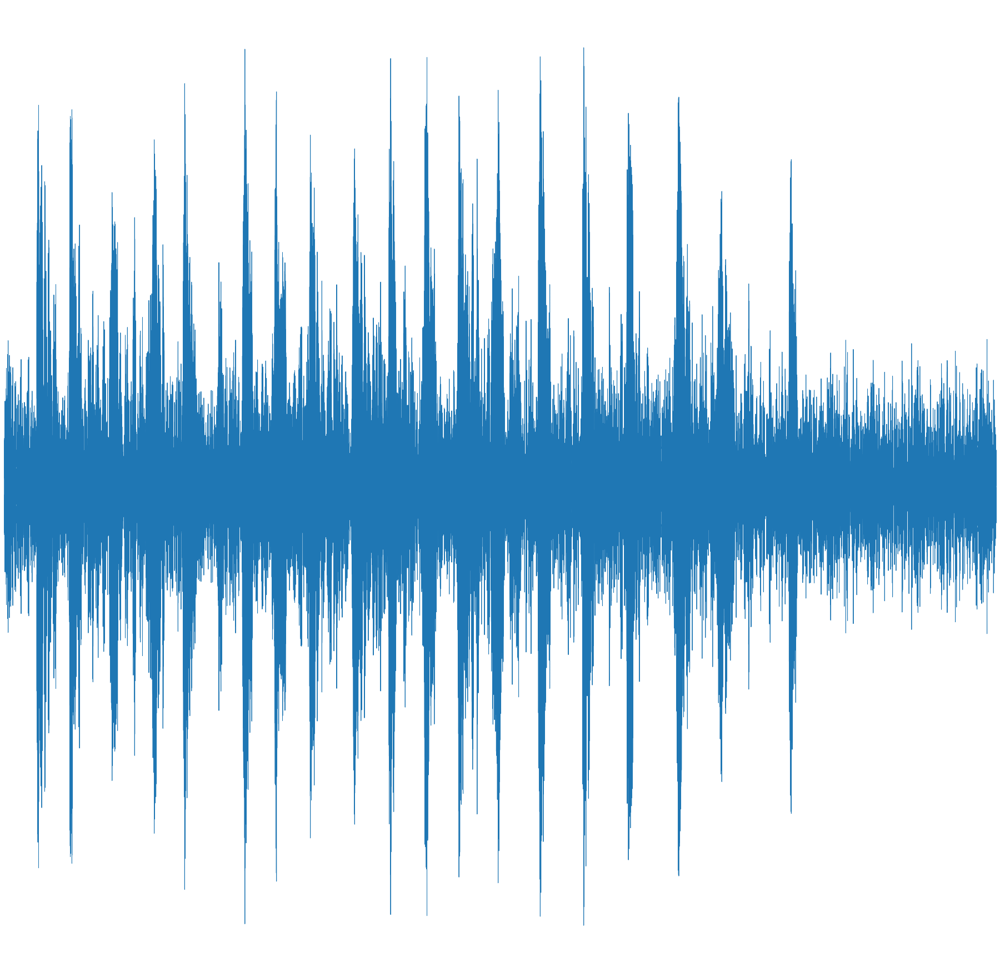

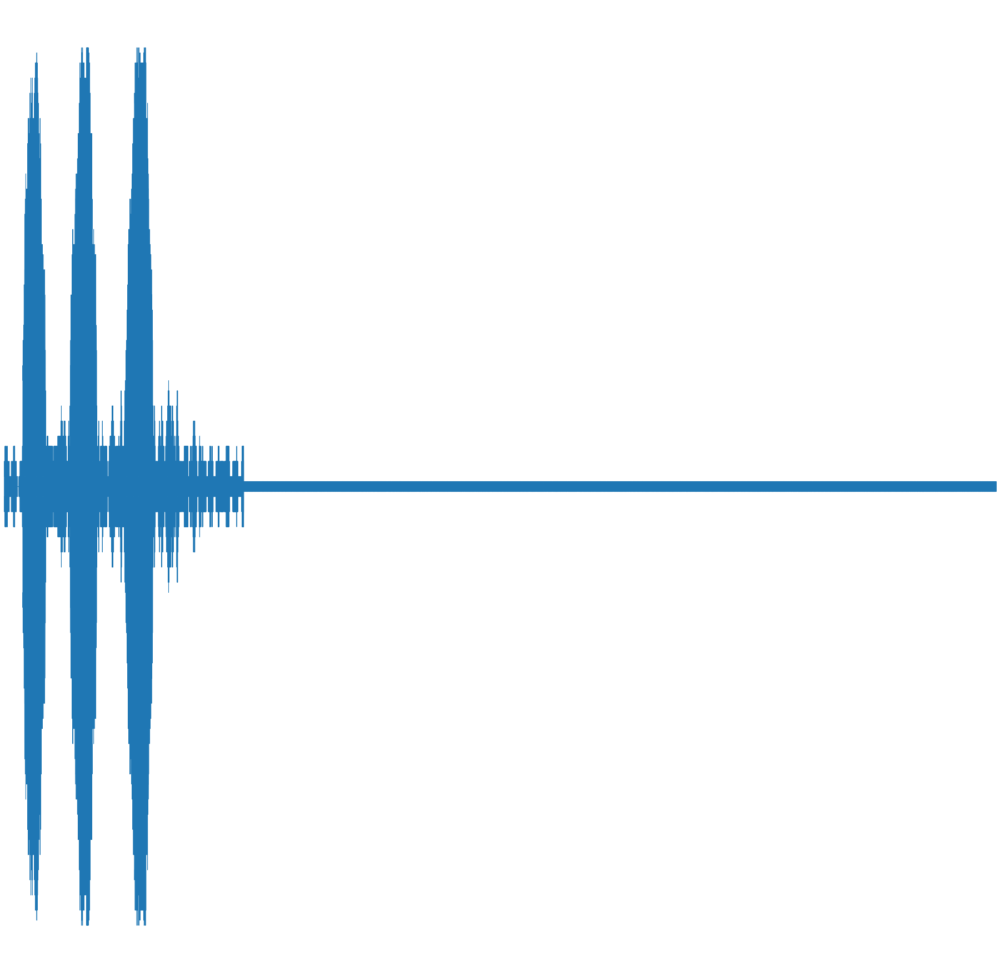

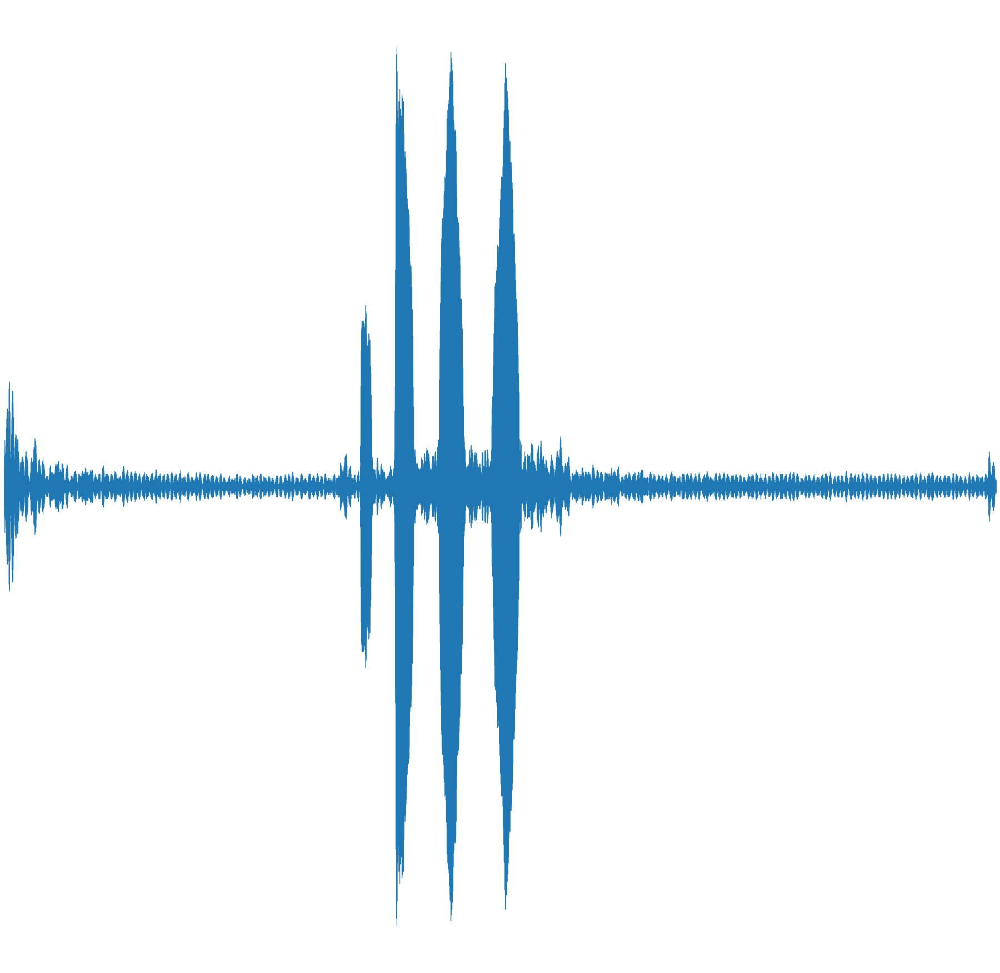

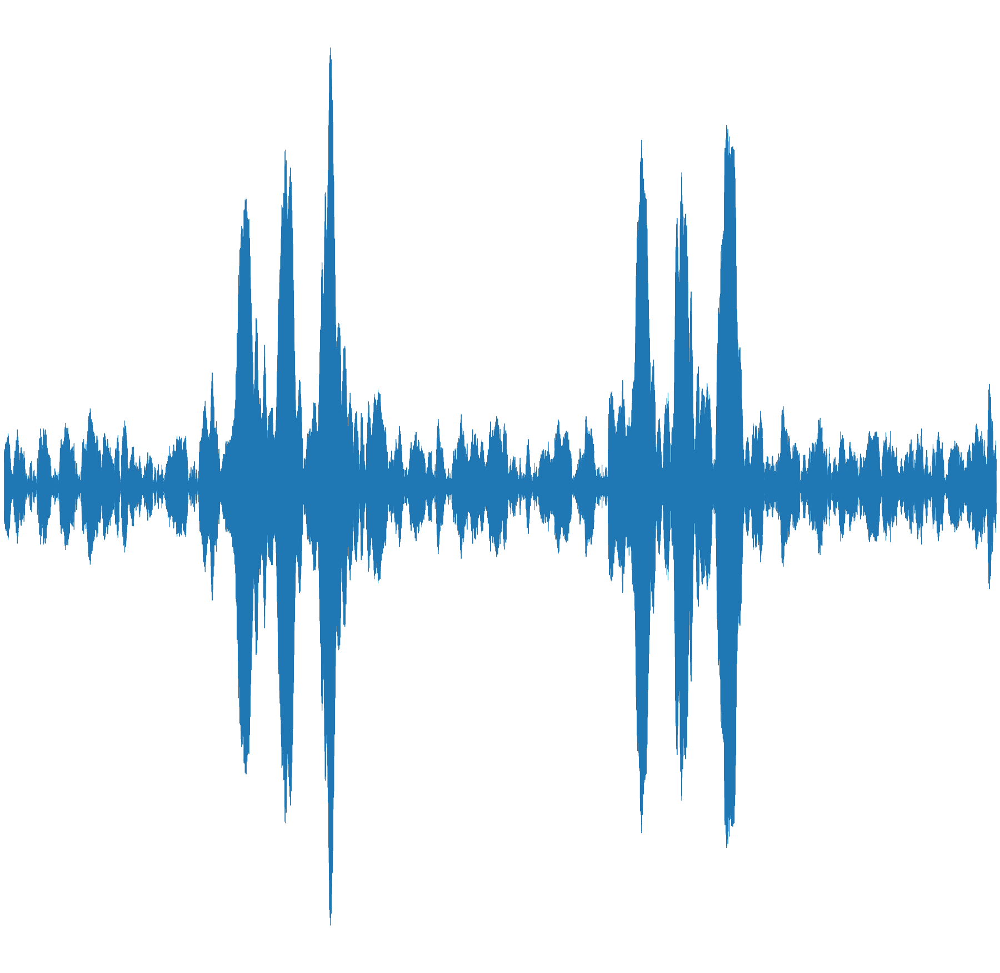

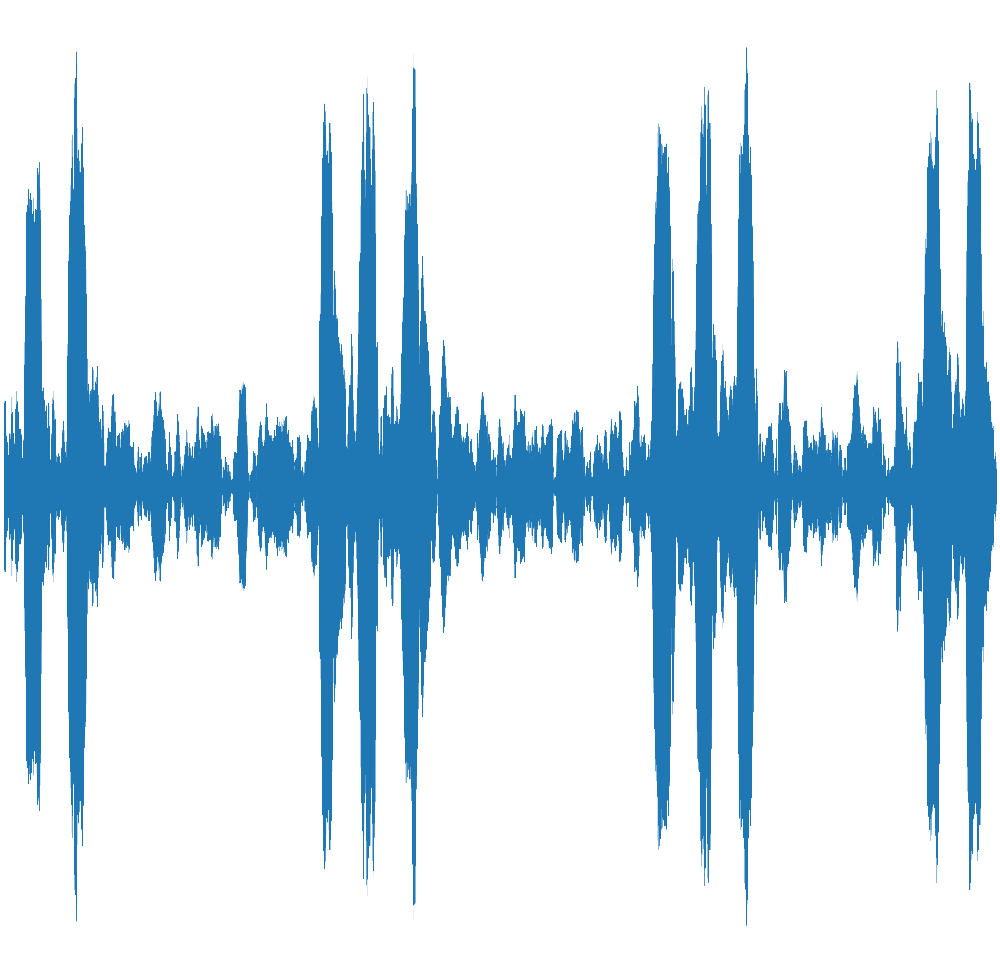

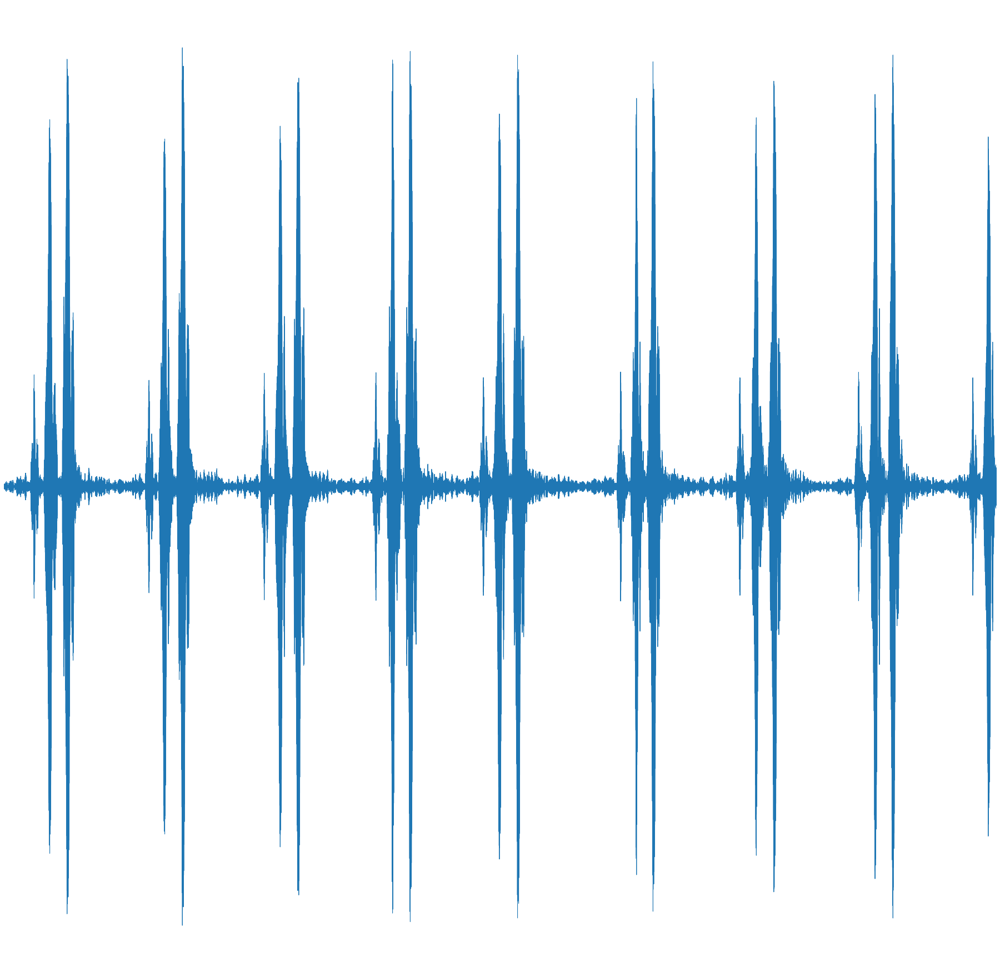

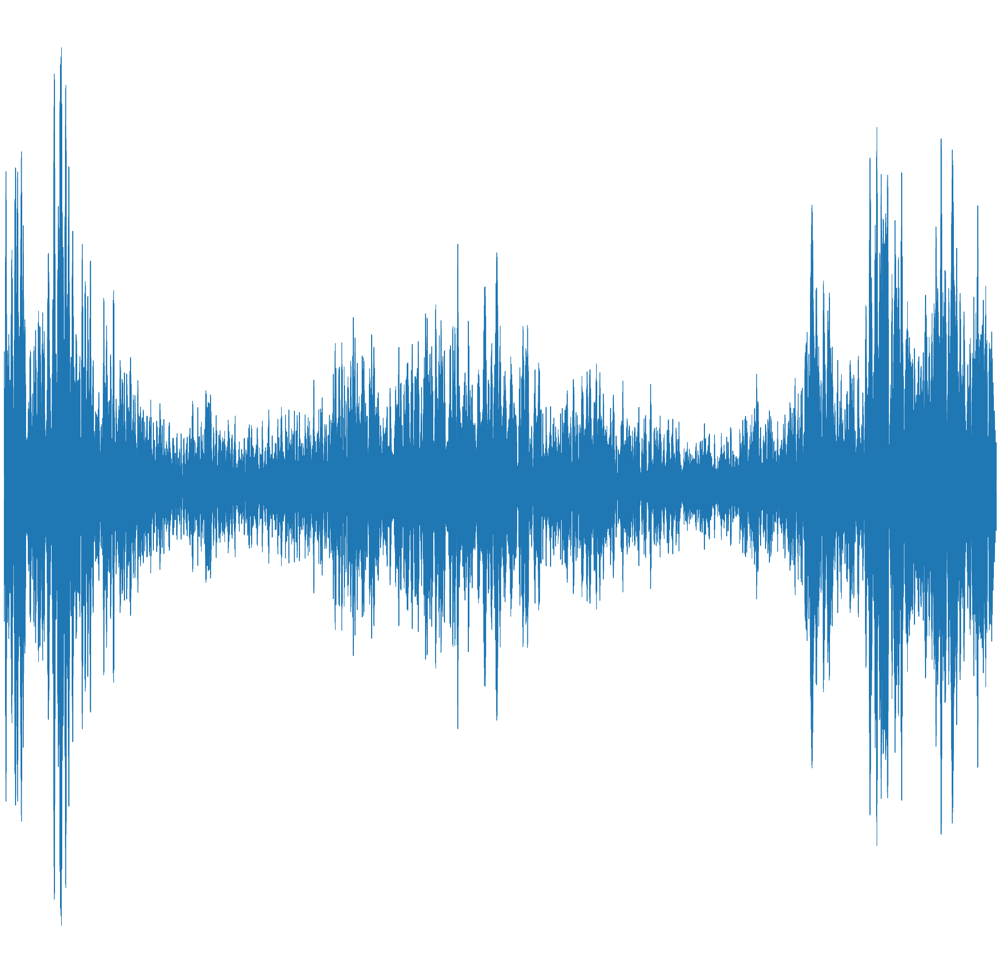

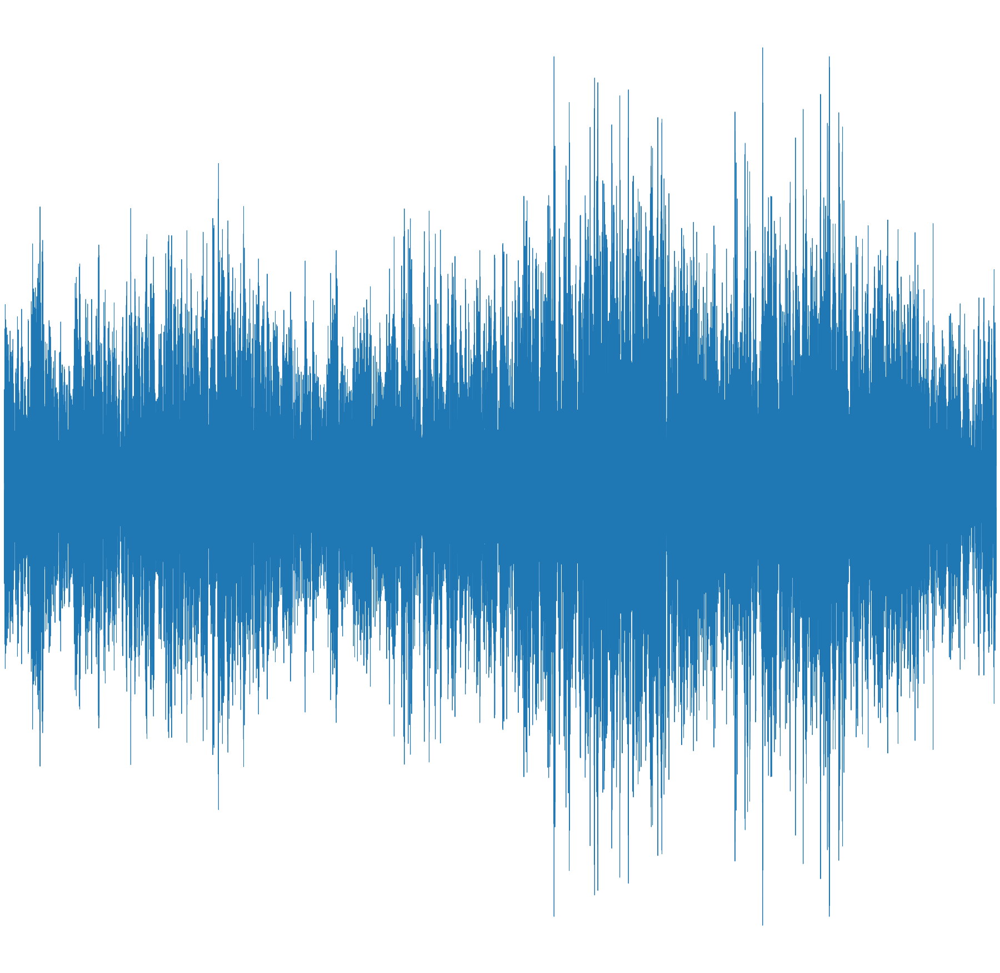

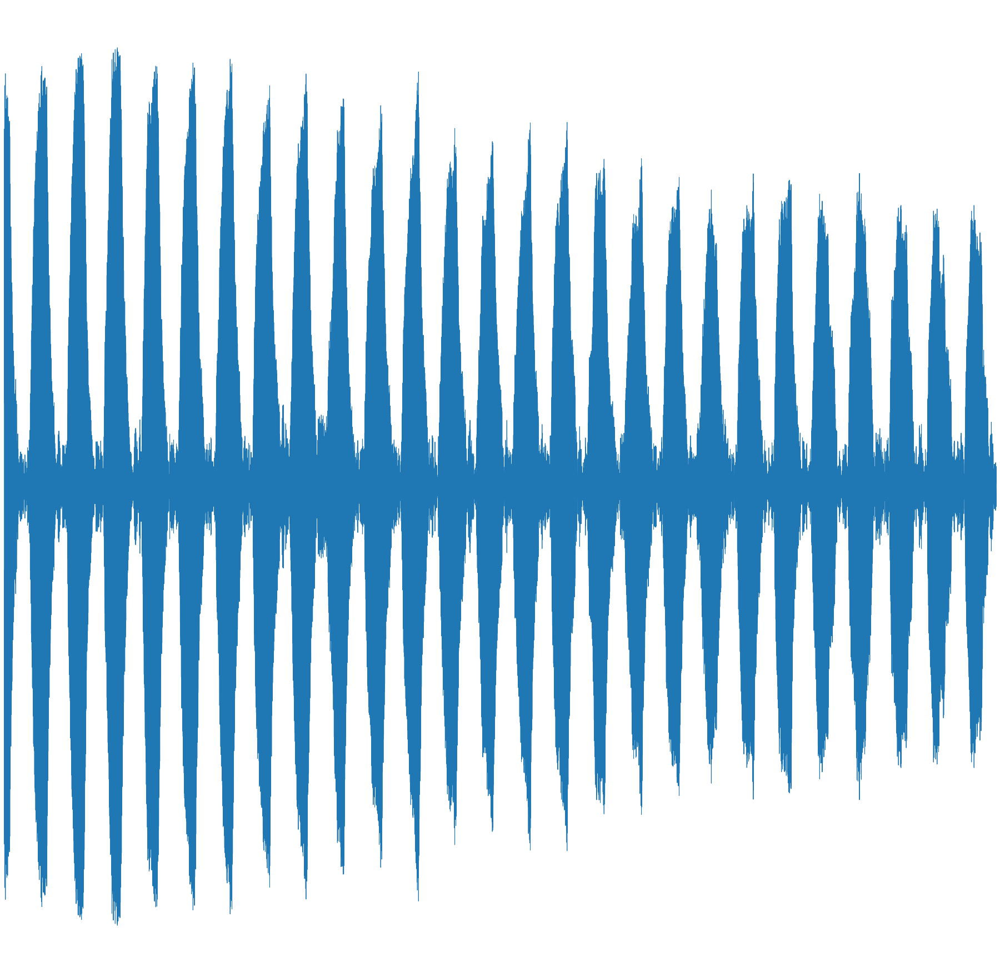

In [5]:
dem = 0
for filename in glob.glob("../content/drive/MyDrive/data/wav/test/4.CRICKET/*.wav"):
  dem=dem+1
  ipd.display(ipd.Audio(filename))
  # load the mp3 file
  signal, sr = librosa.load(filename, duration=10)  # sr = sampling rate

  # plot recording signal
  fig = plt.figure(figsize=[32,32])
  ax = fig.add_subplot(111)
  ax.axes.get_xaxis().set_visible(False)
  ax.axes.get_yaxis().set_visible(False)
  ax.set_frame_on(False)
  librosa.display.waveplot(signal, sr=sr)
  #plt.title("Cat sound "+ str(dem))
  #plt.savefig('../content/drive/MyDrive/data/test/4.CRICKET/%04d.png'%(dem), bbox_inches='tight')
  plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # Remove the CWD from sys.path while we load stuff.


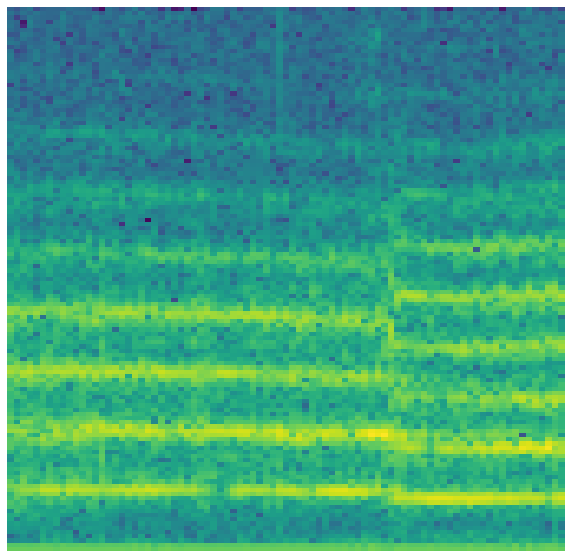

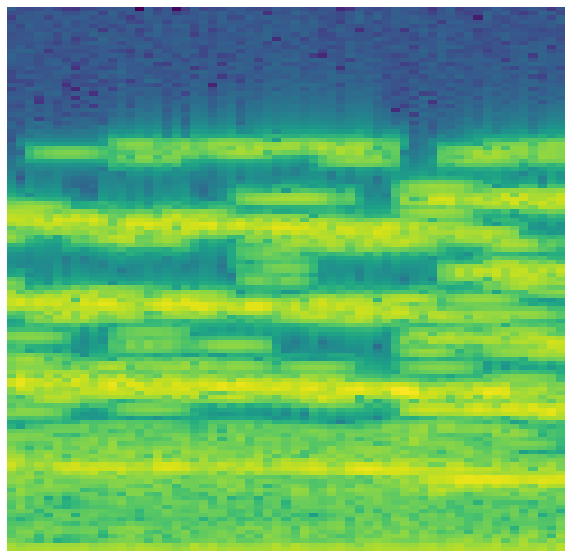

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


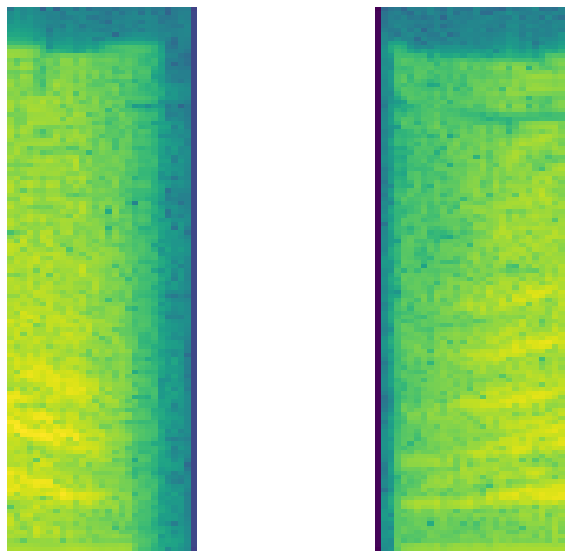

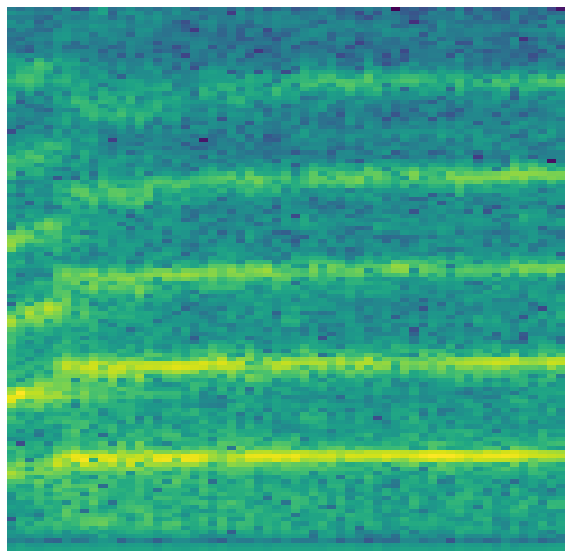

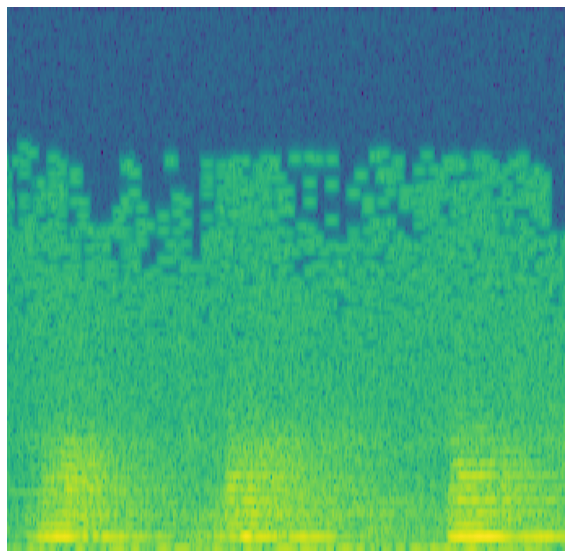

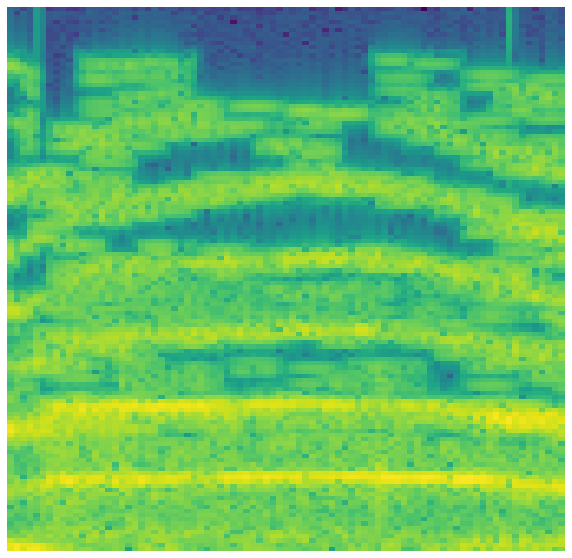

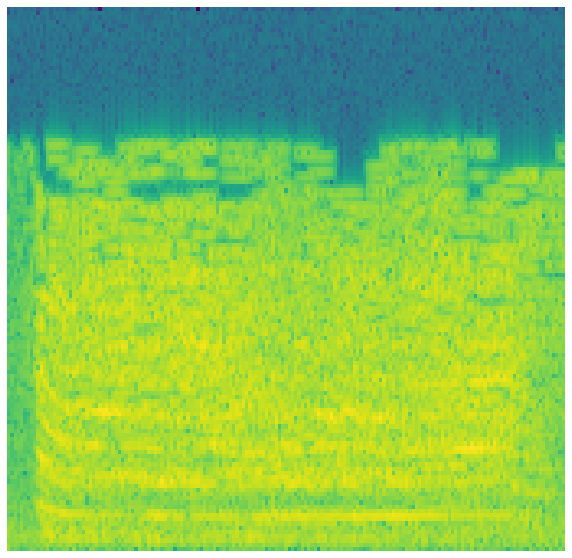

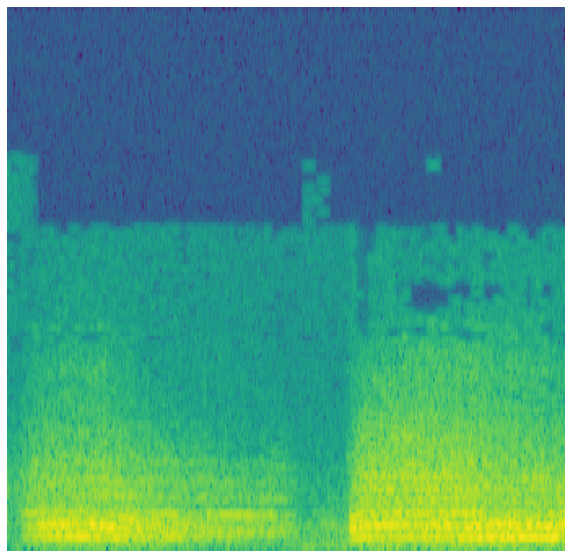

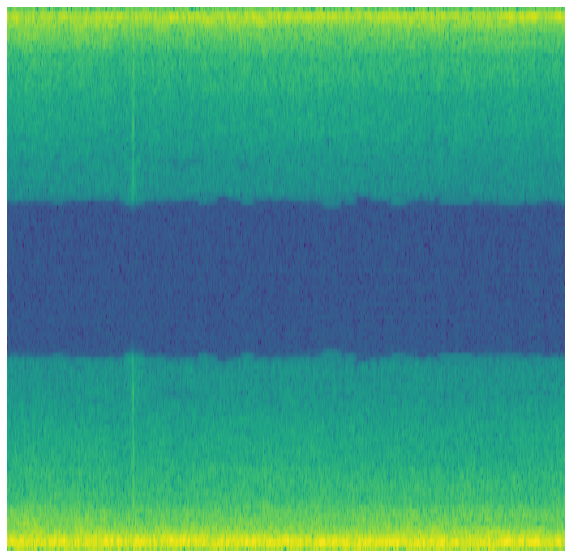

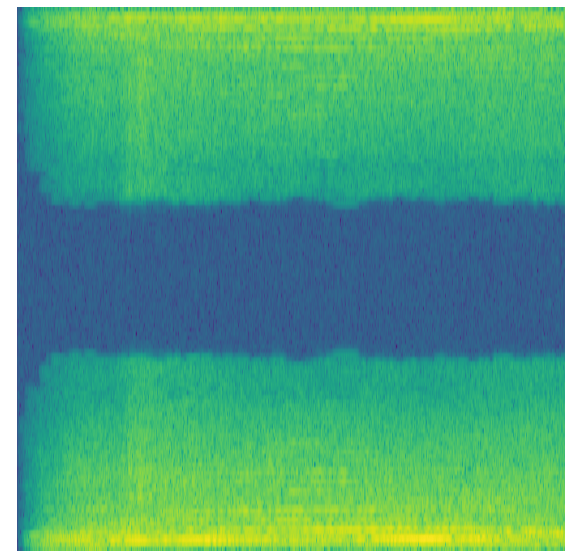

In [7]:
dem = 0

def graph_spectrogram(wav_file):
    sound_info, frame_rate = get_wav_info(wav_file)
    fig = plt.figure(num=None, figsize=(10, 10))
    ax = fig.add_subplot(111)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.set_frame_on(False)
    plt.subplot(111)
    #pylab.title('spectrogram of %r' % wav_file)
    plt.specgram(sound_info, Fs=frame_rate)
    #plt.savefig('spectrogram.png')
def get_wav_info(wav_file):
    wav = wave.open(wav_file, 'r')
    frames = wav.readframes(-1)
    sound_info = pylab.fromstring(frames, 'int16')
    frame_rate = wav.getframerate()
    wav.close()
    return sound_info, frame_rate

for filename in glob.glob("../content/drive/MyDrive/data/wav/test/9.ELEPHANT/*.wav"):
  dem=dem+1
  ipd.display(ipd.Audio(filename))
  # load the mp3 file
  signal, sr = librosa.load(filename, duration=10)  # sr = sampling rate

  get_wav_info(filename)
  graph_spectrogram(filename)
  #plt.colorbar(format="%+2.0f dB")
  #plt.title("Mel-scaled spectrogram")
  #plt.title("Cat sound "+ str(dem))
  plt.savefig('../content/drive/MyDrive/data/test/9.ELEPHANT/%04d.png'%(dem), bbox_inches='tight')
  plt.show()

In [ ]:
import cv2
cv2.imwrite('../content/drive/MyDrive/data/test/1.CAT/Image.jpg', image_name)

In [19]:
dir_test = "../content/drive/MyDrive/data/test"
dir_train = "../content/drive/MyDrive/data/train"
dir_wav_test = "../content/drive/MyDrive/data/wav/test"
dir_wav_train = "../content/drive/MyDrive/data/wav/train"

def graph_spectrogram(wav_file):
    sound_info, frame_rate = get_wav_info(wav_file)
    fig = plt.figure(num=None, figsize=(10, 10))
    ax = fig.add_subplot(111)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.set_frame_on(False)
    plt.subplot(111)
    #pylab.title('spectrogram of %r' % wav_file)
    plt.specgram(sound_info, Fs=frame_rate)
    #plt.savefig('spectrogram.png')
def get_wav_info(wav_file):
    wav = wave.open(wav_file, 'r')
    frames = wav.readframes(-1)
    sound_info = pylab.fromstring(frames, 'int16')
    frame_rate = wav.getframerate()
    wav.close()
    return sound_info, frame_rate

for animal_name in glob.glob(dir_wav_test+"/*"):
  print(animal_name+"/*.wav")



../content/drive/MyDrive/data/wav/test/3.CHICKEN/*.wav
../content/drive/MyDrive/data/wav/test/6.FROG/*.wav
../content/drive/MyDrive/data/wav/test/9.ELEPHANT/*.wav
../content/drive/MyDrive/data/wav/test/1.CAT/*.wav
../content/drive/MyDrive/data/wav/test/7.MONKEY/*.wav
../content/drive/MyDrive/data/wav/test/2.DOG/*.wav
../content/drive/MyDrive/data/wav/test/5.DUCK/*.wav
../content/drive/MyDrive/data/wav/test/10.COW/*.wav
../content/drive/MyDrive/data/wav/test/8.GOAT/*.wav
../content/drive/MyDrive/data/wav/test/4.CRICKET/*.wav


In [26]:
dir_test = "../content/drive/MyDrive/data/test"
dir_train = "../content/drive/MyDrive/data/train"
dir_wav_test = "../content/drive/MyDrive/data/wav/test"
dir_wav_train = "../content/drive/MyDrive/data/wav/train"

def graph_spectrogram(wav_file):
    sound_info, frame_rate = get_wav_info(wav_file)
    fig = plt.figure(num=None, figsize=(10, 10))
    ax = fig.add_subplot(111)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.set_frame_on(False)
    plt.subplot(111)
    #pylab.title('spectrogram of %r' % wav_file)
    plt.specgram(sound_info, Fs=frame_rate)
    #plt.savefig('spectrogram.png')
def get_wav_info(wav_file):
    wav = wave.open(wav_file, 'r')
    frames = wav.readframes(-1)
    sound_info = pylab.fromstring(frames, 'int16')
    frame_rate = wav.getframerate()
    wav.close()
    return sound_info, frame_rate

for animal_name in glob.glob(dir_wav_test+"/*"):
  dem = 0
  for file_name in glob.glob(animal_name+"/*.wav"):
      print(animal_name[0:30]+animal_name[34:])

../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/3.CHICKEN
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/6.FROG
../content/drive/MyDrive/data/test/9.ELEPHANT
../content/drive/MyDrive/data/test/9.ELEPHANT
../content/drive/MyDrive/data/test/9.ELEPHANT
../content/drive/MyDrive/data/test/9.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  del sys.path[0]


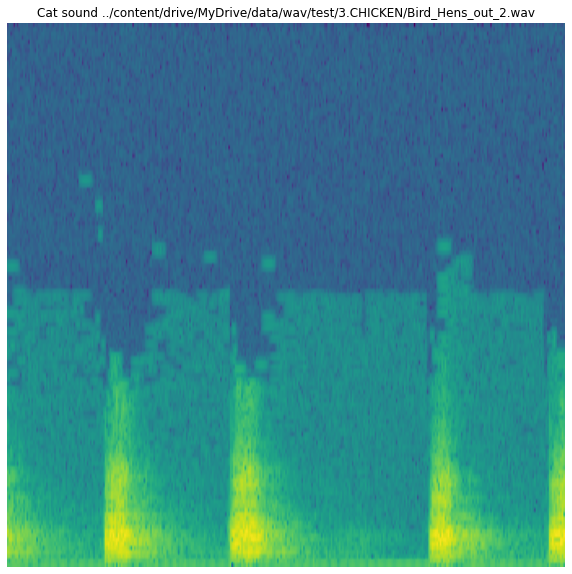

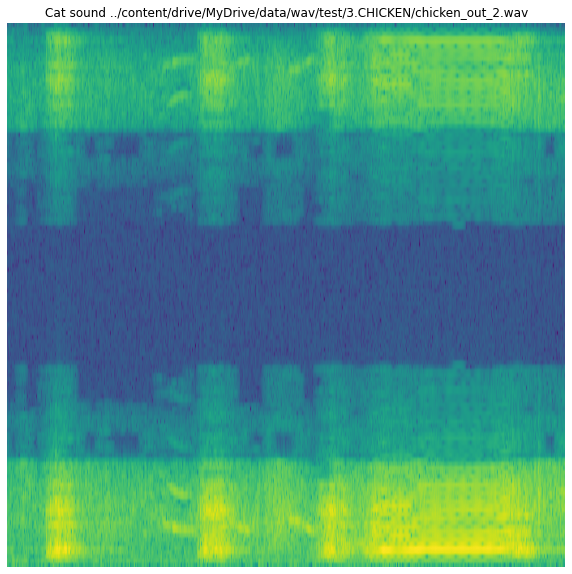

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


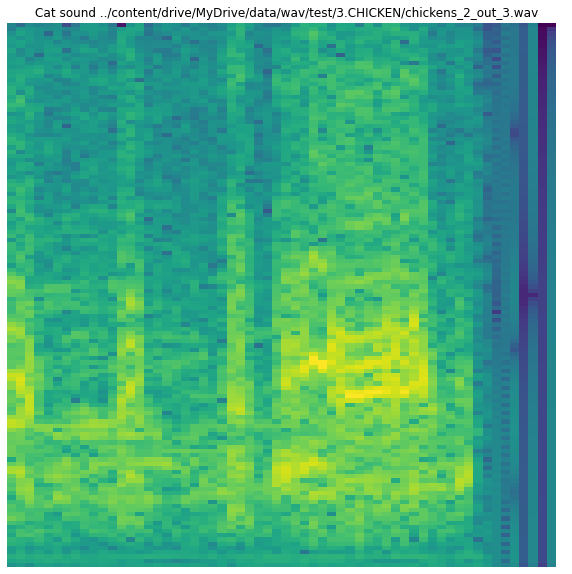

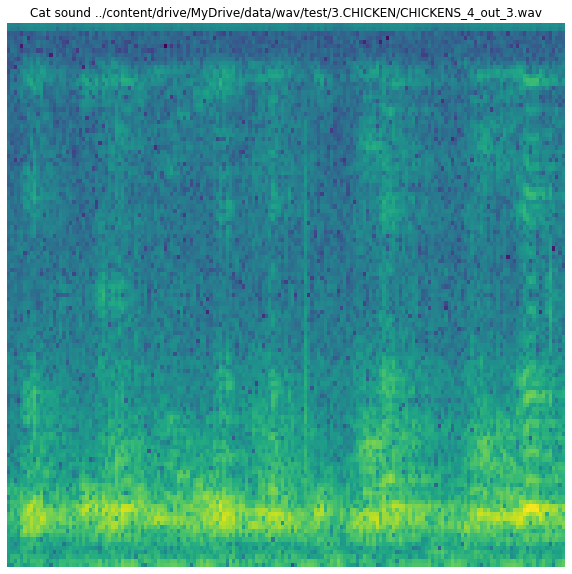

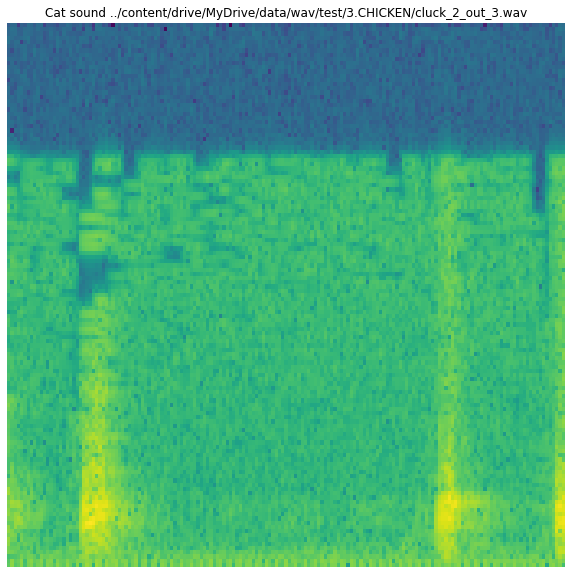

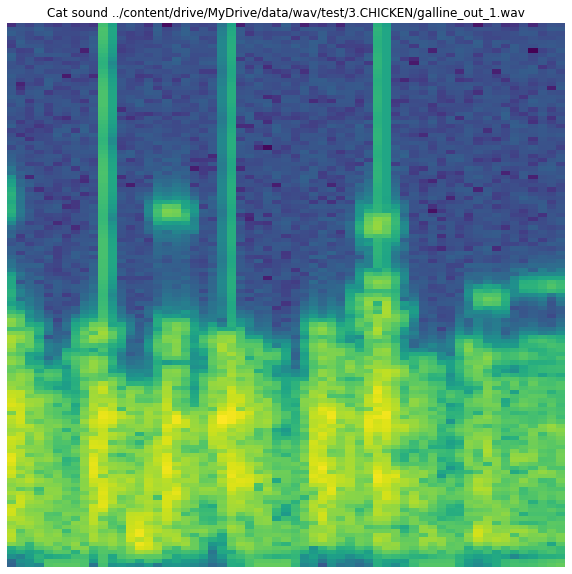

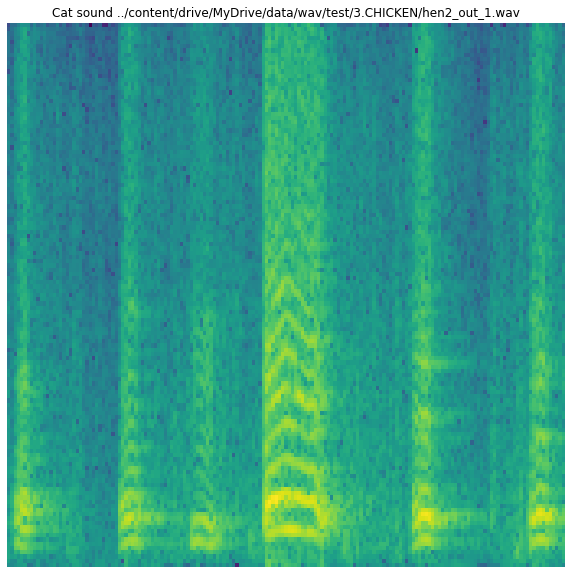

...

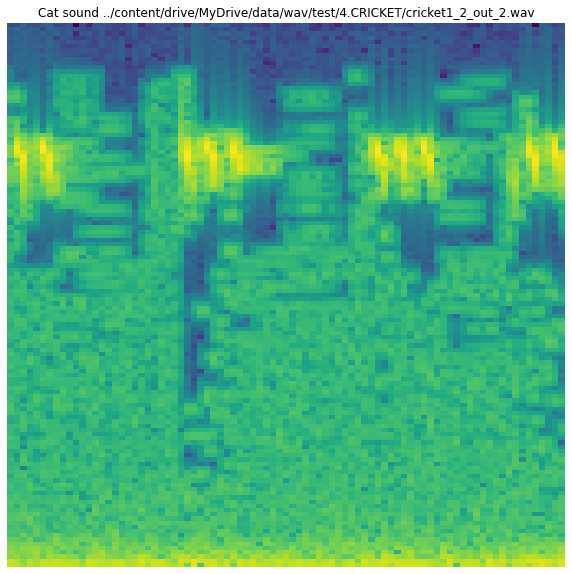

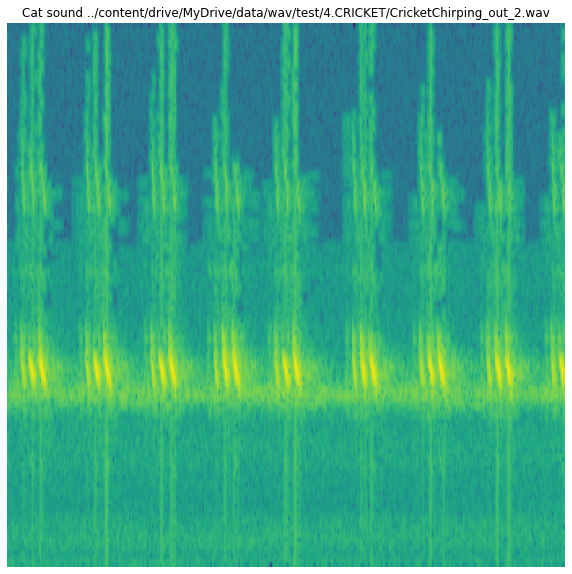

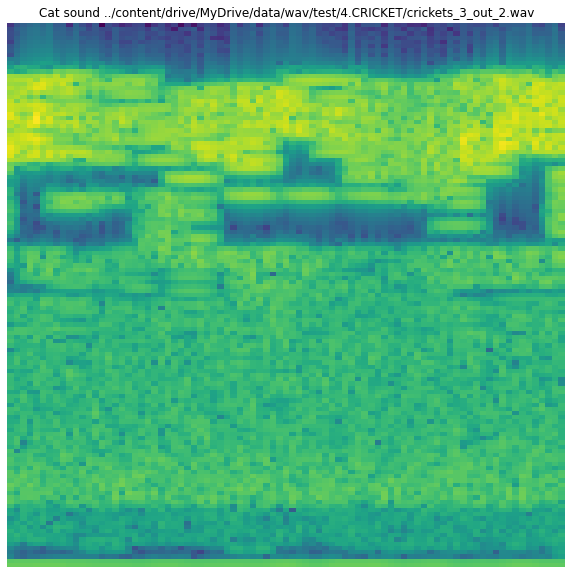

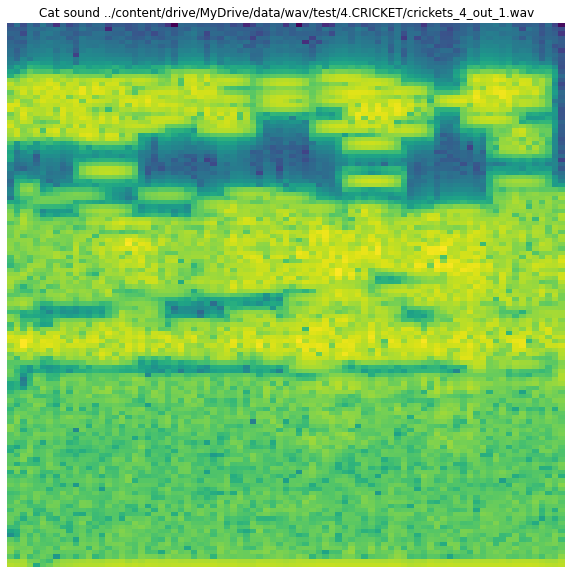

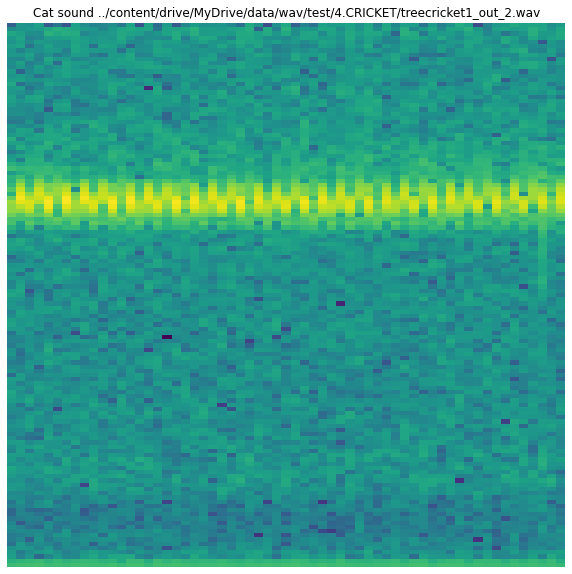

In [29]:
dir_test = "../content/drive/MyDrive/data/test"
dir_train = "../content/drive/MyDrive/data/train"
dir_wav_test = "../content/drive/MyDrive/data/wav/test"
dir_wav_train = "../content/drive/MyDrive/data/wav/train"

def graph_spectrogram(wav_file):
    sound_info, frame_rate = get_wav_info(wav_file)
    fig = plt.figure(num=None, figsize=(10, 10))
    ax = fig.add_subplot(111)
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.set_frame_on(False)
    plt.subplot(111)
    #pylab.title('spectrogram of %r' % wav_file)
    plt.specgram(sound_info, Fs=frame_rate)
    #plt.savefig('spectrogram.png')
def get_wav_info(wav_file):
    wav = wave.open(wav_file, 'r')
    frames = wav.readframes(-1)
    sound_info = pylab.fromstring(frames, 'int16')
    frame_rate = wav.getframerate()
    wav.close()
    return sound_info, frame_rate

for animal_name in glob.glob(dir_wav_test+"/*"):
  dem = 0
  for file_name in glob.glob(animal_name+"/*.wav"):
    dem=dem+1
    ipd.display(ipd.Audio(file_name))
    # load the mp3 file
    signal, sr = librosa.load(file_name, duration=10)  # sr = sampling rate
    get_wav_info(file_name)
    graph_spectrogram(file_name)
    #plt.colorbar(format="%+2.0f dB")
    #plt.title("Mel-scaled spectrogram")
    plt.title("Cat sound "+ file_name)
    plt.savefig(animal_name[0:30]+animal_name[34:] + '/%04d.png'%(dem), bbox_inches='tight')
    plt.show()